#**Music Recommender Systems**

#**Reza Dehkordi, Tin Tran, Peeyush Samba**

#**5/02/21**

 
#**OVERVIEW**
 
1. What business problem are we trying to solve and why?
 
Technology is rapidly changing the lives of people all around the world. Technology over recent years has had a tremendous impact on the way we entertain ourselves and buy products. Machine Learning models have allowed us to identify solutions to seemingly impossible business problems with minimal human interaction. A number of industries are using recommendation engines to improve their efficiency and how effective they are in recommending entities to their audience. Recommendation engines can be described as “essentially a solution that allows marketers to offer their customers relevant product recommendations in real-time" [Cite](https://marutitech.com/recommendation-engine-benefits/). For example, an ecommerce site like Amazon would use a recommendation engine to try to predict what products the customer would buy based on their previous purchases. Netflix, a company that revolutionized how people consume entertainment, built recommendation engines that allow people to binge watch shows, allowing companies to retain a steady consumer base, and cam have a tremendous impact on the revenue of the company. 
 
The business problem that this project is specifically trying to solve is to create a recommendation engine for music as this is a very popular application of recommendation engines. Today Spotify, Apple Music, Tidal, other music streaming services are using complex recommender engines to make suggestions to users based on data that is gathered as soon as the user starts interacting with the services. This problem will solved by building a recommendation system using a subset of the data that exists in the Million Song Dataset, which will be discussed in more detail in the Data section of the notebook. 
 
In the industry there are multiple different types of recommender systems that can effectively recommend content to users, the following is a brief introduction [Cite](https://www.bluepiit.com/blog/classifying-recommender-systems/#:~:text=There%20are%20majorly%20six%20types,system%20and%20Hybrid%20recommender%20system.):
 
1. Collaborative Filtering
2. Content Based Filtering 
3. Demographic Based
4. Utility Based
5. Knowledge Based
6. Hybrid Recommender
 
In this NoteBook we will further explore the algorithms that fall under the umbrella of Collaborative Filtering and Content Based Filtering.
 
 
 
 



#**DATA** 


Data Comes from:
Thierry Bertin-Mahieux, Daniel P.W. Ellis, Brian Whitman, and Paul Lamere. 
The Million Song Dataset. In Proceedings of the 12th International Society
for Music Information Retrieval Conference (ISMIR 2011), 2011.

Description:
"The Million Song Dataset is a freely-available collection of audio features and metadata for a million contemporary popular music tracks". The data comes from The Echo Nest, which is a music intelligence and data platform for developers, which is actually owned by spotify. This dataset is a very popular dataset people use to build recommender engines, which can also be used commercially. Since the original dataset is so large (over 300 GB), the subset of this dataset will be used, which will only contain about 7000 songs. In the original dataset, there are over 50 variables, however, this project will only use a subset number of variables in order to create recomender engines (each variable that is being used has a description of what it means below)[Cite](https://http://millionsongdataset.com/)


**There are many variables in this dataset, however, we will be only using a few of these variables to make our models and program more efficient. Therefore, below columns are the variables we will be using in the rest of the program. Following are the variables that are used as well as used as well as definition of what each variable, according to the dataset source itself**

**Data Dictionary - Variable Meaning:**
            
**artist_hotttnesss** - algorithmic estimation of how hot (good) an artist is	           
**artist_id** - Echo Nest ID (unique id for each artist)                    
**artist_location** - location of where the artist is from                                                                      
**release** - album name	                      
**release_7digitalid** - Unique id for each album	                          
**similar_artists** - Echo Nest artist IDs (sim. algo. unpublished)	              
**song_hotttnesss**  - algorithmic estimation	of how hot (good) a song is               
**song_id**  - Echo Nest song ID (unique id for each song)	                      
**title** - song title	                                                          
**year** - song release year from MusicBrainz or 0	if data is not availible     
**user_id** - Id of a unique user

**listen_count** - How many times the user listened to that song                 

In [ ]:
#Load up our packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib


from sklearn.model_selection import train_test_split
%matplotlib inline

#Load the downloaded data from 
#load data, the data is raw from subha5gemini github page
songs_metadata_file = pd.read_csv('https://raw.githubusercontent.com/subha5gemini/MillionSongDataset/master/subset-compiled.csv')

In [ ]:
#how much data and variables do we have in the dataset (10000 rows x 54 columns)
songs_metadata_file.count

<bound method DataFrame.count of       analysis_sample_rate  artist_7digitalid  ...               track_id  year
0                    22050             165270  ...  b'TRAAAAW128F429D538'     0
1                    22050               1998  ...  b'TRAAABD128F429CF47'  1969
2                    22050             290021  ...  b'TRAAADZ128F9348C2E'     0
3                    22050              19072  ...  b'TRAAAEF128F4273421'  1982
4                    22050              30973  ...  b'TRAAAFD128F92F423A'  2007
...                    ...                ...  ...                    ...   ...
9995                 22050              52613  ...  b'TRBIJMU12903CF892B'  1998
9996                 22050               7247  ...  b'TRBIJNF128F14815A7'  1998
9997                 22050               7562  ...  b'TRBIJNK128F93093EC'     0
9998                 22050              68313  ...  b'TRBIJRN128F425F3DD'     0
9999                 22050              39252  ...  b'TRBIJYB128F14AE326'  2005

[10000

In [ ]:
#How many values exist in each column, we can see some variables do not have all 10,000 values, these are likely null values
songs_metadata_file.count()

analysis_sample_rate          10000
artist_7digitalid             10000
artist_familiarity             9996
artist_hotttnesss             10000
artist_id                     10000
artist_latitude                3742
artist_location               10000
artist_longitude               3742
artist_mbid                   10000
artist_mbtags                 10000
artist_mbtags_count           10000
artist_name                   10000
artist_playmeid               10000
artist_terms                  10000
artist_terms_freq             10000
artist_terms_weight           10000
audio_md5                     10000
bars_confidence               10000
bars_start                    10000
beats_confidence              10000
beats_start                   10000
danceability                  10000
duration                      10000
end_of_fade_in                10000
energy                        10000
key                           10000
key_confidence                10000
loudness                    

In [ ]:
#Display the output, the data "head", the first few lines of the dataset
songs_metadata_file.head()

,analysis_sample_rate,artist_7digitalid,artist_familiarity,artist_hotttnesss,artist_id,artist_latitude,artist_location,artist_longitude,artist_mbid,artist_mbtags,artist_mbtags_count,artist_name,artist_playmeid,artist_terms,artist_terms_freq,artist_terms_weight,audio_md5,bars_confidence,bars_start,beats_confidence,beats_start,danceability,duration,end_of_fade_in,energy,key,key_confidence,loudness,mode,mode_confidence,release,release_7digitalid,sections_confidence,sections_start,segments_confidence,segments_loudness_max,segments_loudness_max_time,segments_loudness_start,segments_pitches,segments_start,segments_timbre,similar_artists,song_hotttnesss,song_id,start_of_fade_out,tatums_confidence,tatums_start,tempo,time_signature,time_signature_confidence,title,track_7digitalid,track_id,year
0,22050,165270,0.581794,0.401998,b'ARD7TVE1187B99BFB1',NaN,b'California - LA',NaN,b'e77e51a5-4761-45b3-9847-2051f811e366',"(0,)","(0,)",b'Casual',4479,"(37,)","(37,)","(37,)",b'a222795e07cd65b7a530f1346f520649',"(83,)","(83,)","(344,)","(344,)",0.0,218.93179,0.247,0.0,1,0.736,-11.197,0,0.636,b'Fear Itself',300848,"(10,)","(10,)","(971,)","(971,)","(971,)","(971,)","(971, 12)","(971,)","(971, 12)","(100,)",0.602120,b'SOMZWCG12A8C13C480',218.932,"(688,)","(688,)",92.198,4,0.778,"b""I Didn't Mean To""",3401791,b'TRAAAAW128F429D538',0
1,22050,1998,0.630630,0.417500,b'ARMJAGH1187FB546F3',35.14968,"b'Memphis, TN'",-90.04892,b'1c78ab62-db33-4433-8d0b-7c8dcf1849c2',"(1,)","(1,)",b'The Box Tops',22066,"(38,)","(38,)","(38,)",b'bb9771eeef3d5b204a3c55e690f52a91',"(73,)","(73,)","(296,)","(296,)",0.0,148.03546,0.148,0.0,6,0.169,-9.843,0,0.430,b'Dimensions',300822,"(9,)","(9,)","(550,)","(550,)","(550,)","(550,)","(550, 12)","(550,)","(550, 12)","(100,)",NaN,b'SOCIWDW12A8C13D406',137.915,"(591,)","(591,)",121.274,4,0.384,b'Soul Deep',3400270,b'TRAAABD128F429CF47',1969
2,22050,290021,0.487357,0.343428,b'ARKRRTF1187B9984DA',NaN,b'',NaN,b'7a273984-edd9-4451-9c4d-39b38f05ebcd',"(0,)","(0,)",b'Sonora Santanera',13951,"(10,)","(10,)","(10,)",b'fa329738005ca53715d9f7381a0d1fe3',"(291,)","(291,)","(291,)","(291,)",0.0,177.47546,0.282,0.0,8,0.643,-9.689,1,0.565,b'Las Numero 1 De La Sonora Santanera',514953,"(8,)","(8,)","(562,)","(562,)","(562,)","(562,)","(562, 12)","(562,)","(562, 12)","(100,)",NaN,b'SOXVLOJ12AB0189215',172.304,"(582,)","(582,)",100.070,1,0.000,b'Amor De Cabaret',5703798,b'TRAAADZ128F9348C2E',0
3,22050,19072,0.630382,0.454231,b'AR7G5I41187FB4CE6C',NaN,"b'London, England'",NaN,b'e188a520-9cb7-4f73-a3d7-2f70c6538e92',"(3,)","(3,)",b'Adam Ant',12697,"(43,)","(43,)","(43,)",b'43cd1abd45d5a2dda16a3c65b4963bd4',"(115,)","(115,)","(462,)","(462,)",0.0,233.40363,0.000,0.0,0,0.751,-9.013,1,0.749,b'Friend Or Foe',287650,"(11,)","(11,)","(821,)","(821,)","(821,)","(821,)","(821, 12)","(821,)","(821, 12)","(100,)",NaN,b'SONHOTT12A8C13493C',217.124,"(924,)","(924,)",119.293,4,0.000,b'Something Girls',3226795,b'TRAAAEF128F4273421',1982
4,22050,30973,0.651046,0.401724,b'ARXR32B1187FB57099',NaN,b'',NaN,b'c6903a2e-063c-4f91-a284-17b8f421be7b',"(0,)","(0,)",b'Gob',8355,"(38,)","(38,)","(38,)",b'580a8fe08ef0f1c7734b84547d7a8bc7',"(110,)","(110,)","(444,)","(444,)",0.0,209.60608,0.066,0.0,2,0.092,-4.501,1,0.371,b'Muertos Vivos',611336,"(9,)","(9,)","(673,)","(673,)","(673,)","(673,)","(673, 12)","(673,)","(673, 12)","(100,)",0.604501,b'SOFSOCN12A8C143F5D',198.699,"(887,)","(887,)",129.738,4,0.562,b'Face the Ashes',6795666,b'TRAAAFD128F92F423A',2007


In [ ]:
!pip install chart_studio

In [ ]:
#THE DATA SEEMS TO BE ENCODED SO WE NEED TO DECODE IT, this will allow use to understand and use the data in an easier way. For example, the b' in artist_id column
#SOURCE TO CLEAN THE DATA: https://github.com/subha5gemini/MillionSongDataset/blob/master/data%20cleaning.ipynb
import re
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.express as px
import chart_studio
import warnings

for i in ['artist_name', 'release', 'title']:
    for j in range(len(songs_metadata_file[i])):
        if songs_metadata_file[i][j][0:2] == "b'":
            temp = songs_metadata_file.loc[j, i]
            songs_metadata_file.loc[j, i] = re.findall(r"'(.*?)'", temp)[0]
        elif songs_metadata_file[i][j][0:2] == 'b"':
            temp = songs_metadata_file.loc[j, i]
            songs_metadata_file.loc[j, i] = re.findall(r"[\"](.*?)[\"]", temp)[0]

cols = set(songs_metadata_file.columns) - set(['artist_name', 'release', 'title'])
for i in cols:
    temp = str(songs_metadata_file[i][0])
    if temp[0] == "b":
        songs_metadata_file[i] = songs_metadata_file[i].str.extract(r"['\"](.*?)['\"]")
    if temp[0] == '(':
        songs_metadata_file[i] = songs_metadata_file[i].str.extract(r'\((.*?)\,')      


songs_metadata_file.loc[songs_metadata_file.artist_playmeid == -1,'artist_playmeid'] = np.nan
songs_metadata_file.loc[songs_metadata_file.year == 0,'year'] = np.nan             


chart_studio.tools.set_credentials_file(username='yyyyyokoko', api_key='NoVGkxcKvi17mgozh7kJ', )
chart_studio.tools.set_config_file(world_readable=True, sharing='public')

map_df = songs_metadata_file.loc[:, ['artist_latitude', 'artist_longitude', 'artist_familiarity', 'artist_name', 'artist_location']].dropna()


In [ ]:
#Drop Colums that are not necessary for our project
songs_metadata_file.drop(['analysis_sample_rate', 'artist_7digitalid', 'similar_artists', 'duration', 'artist_familiarity', 'key_confidence', 'loudness', 'key', 'danceability', 'energy', 'artist_mbid', 'artist_playmeid', 'artist_mbtags', 'artist_mbtags_count', 'artist_terms', 'artist_terms_freq', 'artist_terms_weight', 'bars_confidence', 'bars_start', 'beats_confidence', 'bars_start', 'beats_start', 'end_of_fade_in', 'mode', 'mode_confidence', 'sections_confidence', 'sections_start', 'segments_confidence', 'segments_loudness_max', 'segments_loudness_max_time', 'segments_loudness_start', 'segments_pitches', 'segments_start', 'segments_timbre', 'start_of_fade_out', 'tatums_confidence', 'tatums_start', 'tempo', 'time_signature', 'time_signature_confidence', 'track_id', 'track_7digitalid'], axis=1, inplace=True)

In [ ]:
#The Dataset with the columns removed
songs_metadata_file.head()

,artist_hotttnesss,artist_id,artist_latitude,artist_location,artist_longitude,artist_name,audio_md5,release,release_7digitalid,song_hotttnesss,song_id,title,year
0,0.401998,ARD7TVE1187B99BFB1,NaN,California - LA,NaN,Casual,a222795e07cd65b7a530f1346f520649,Fear Itself,300848,0.602120,SOMZWCG12A8C13C480,I Didn't Mean To,NaN
1,0.417500,ARMJAGH1187FB546F3,35.14968,"Memphis, TN",-90.04892,The Box Tops,bb9771eeef3d5b204a3c55e690f52a91,Dimensions,300822,NaN,SOCIWDW12A8C13D406,Soul Deep,1969.0
2,0.343428,ARKRRTF1187B9984DA,NaN,,NaN,Sonora Santanera,fa329738005ca53715d9f7381a0d1fe3,Las Numero 1 De La Sonora Santanera,514953,NaN,SOXVLOJ12AB0189215,Amor De Cabaret,NaN
3,0.454231,AR7G5I41187FB4CE6C,NaN,"London, England",NaN,Adam Ant,43cd1abd45d5a2dda16a3c65b4963bd4,Friend Or Foe,287650,NaN,SONHOTT12A8C13493C,Something Girls,1982.0
4,0.401724,ARXR32B1187FB57099,NaN,,NaN,Gob,580a8fe08ef0f1c7734b84547d7a8bc7,Muertos Vivos,611336,0.604501,SOFSOCN12A8C143F5D,Face the Ashes,2007.0


**User Data**

In the metadata data set, there is no users. However, user data exists for this data. Therefore, the metadata file needs to be connected to the user data in order to recommend music to users. 

In [ ]:
#Since users do not exist in our data, lets use existing data and assign them to the songs that exist in our dataset
user_file = pd.read_csv('https://raw.githubusercontent.com/psamba2/DS/main/10000.txt', delimiter = "\t")

In [ ]:
#Label Our Columns
user_file.columns = ['user_id', 'song_id', 'listen_count']

In [ ]:
user_file.head()

,user_id,song_id,listen_count
0,3f8d0537f042f01759661f353cb515943f463664,SODNXDD12AB018331A,1
1,3f8d0537f042f01759661f353cb515943f463664,SODQGBE12A6D4F6BAB,1
2,3f8d0537f042f01759661f353cb515943f463664,SOEGIYH12A6D4FC0E3,17
3,3f8d0537f042f01759661f353cb515943f463664,SOGBXDU12AB018791F,1
4,3f8d0537f042f01759661f353cb515943f463664,SOHLLRP12A6701F2F4,1


In [ ]:
#Merge our existing Dataset on where we have information about the user dataset
songs_metadata_file = pd.merge(user_file, songs_metadata_file, on="song_id", how="left")

**Final Dataset**

In [ ]:
#Though it is useful to have as much data as possible for running, the program crashes with a subset larger than 7000
#There seems to be no right way to do this so we will get rid of rows with nulls in order to reduce the data into a subset
songs_metadata_file = songs_metadata_file[songs_metadata_file['title'].notna()]
songs_metadata_file = songs_metadata_file[songs_metadata_file['artist_latitude'].notna()]
songs_metadata_file = songs_metadata_file[songs_metadata_file['artist_longitude'].notna()]
songs_metadata_file = songs_metadata_file[songs_metadata_file['song_hotttnesss'].notna()]
songs_metadata_file = songs_metadata_file[songs_metadata_file['year'].notna()]

In [ ]:
songs_metadata_file.count()

user_id               7040
song_id               7040
listen_count          7040
artist_hotttnesss     7040
artist_id             7040
artist_latitude       7040
artist_location       7040
artist_longitude      7040
artist_name           7040
audio_md5             7040
release               7040
release_7digitalid    7040
song_hotttnesss       7040
title                 7040
year                  7040
dtype: int64

In [ ]:
songs_metadata_file.head()

,user_id,song_id,listen_count,artist_hotttnesss,artist_id,artist_latitude,artist_location,artist_longitude,artist_name,audio_md5,release,release_7digitalid,song_hotttnesss,title,year
575,b0dda4d19938ca9649132a56c6c3e3eb6c5c7bf8,SOZAPQT12A8C142821,1,0.788806,ARF2EHS1187B994F4E,36.16778,"Nashville, Tennessee",-86.77836,Kings Of Leon,0be6112bdec17baf53301644a193fecb,Because Of The Times,311865.0,0.746161,Ragoo,2007.0
685,6b9109493a5f3a073aa487bc34758cca09b12751,SOTRDVJ12A8C13975E,12,0.779968,ARPAAHK1187B9ABB00,49.26044,"Hanna, Alberta, Canada",-123.11403,Nickelback,68d7fd37cb815737d4ccf81300312e40,NOW (That's What I Call Music) 22,570867.0,0.836455,Savin' Me,2005.0
1008,574ff2cbd8b4b8309dcdb40811b00b52d4815f4e,SOTRDVJ12A8C13975E,1,0.779968,ARPAAHK1187B9ABB00,49.26044,"Hanna, Alberta, Canada",-123.11403,Nickelback,68d7fd37cb815737d4ccf81300312e40,NOW (That's What I Call Music) 22,570867.0,0.836455,Savin' Me,2005.0
1012,574ff2cbd8b4b8309dcdb40811b00b52d4815f4e,SOWEUOO12A6D4F6D0C,1,0.791143,ARQUMH41187B9AF699,34.05349,"Los Angeles, CA",-118.24532,Linkin Park,5e21ff26ddc88681b57018e2be3a7baa,Minutes To Midnight,85606.0,0.586925,Given Up (Album Version),2007.0
1063,32a0f638f580535174da5dc1dea73ee4ee40ee60,SOEKSGJ12A67AE227E,1,0.791143,ARQUMH41187B9AF699,34.05349,"Los Angeles, CA",-118.24532,Linkin Park,9a2211c39fdd2870662e5c95e786a840,Hybrid Theory,18150.0,0.872229,Crawling (Album Version),2000.0


#**EXPLORATORY DATA ANALYIS (EDA)** 

In [ ]:
#check the shape of the data frame
songs_metadata_file.shape

(7040, 15)

In [ ]:
#Check how many nulls there are for each variable and count how many there are
#It looks like there are none for most variables, but there are none values for song_hotttnesss and year.                  
songs_metadata_file.isnull().sum() #To check for missing values

user_id               0
song_id               0
listen_count          0
artist_hotttnesss     0
artist_id             0
artist_latitude       0
artist_location       0
artist_longitude      0
artist_name           0
audio_md5             0
release               0
release_7digitalid    0
song_hotttnesss       0
title                 0
year                  0
dtype: int64

In [ ]:
#Summary of variables, simiply some general data about the file 
songs_metadata_file.describe()

,listen_count,artist_hotttnesss,artist_latitude,artist_longitude,release_7digitalid,song_hotttnesss,year
count,7040.000000,7040.000000,7040.000000,7040.000000,7040.000000,7040.000000,7040.000000
mean,2.676420,0.694305,36.959431,-82.230563,391958.391903,0.812501,2003.292330
std,4.288715,0.120475,13.574713,36.525330,297348.941727,0.177639,8.674607
min,1.000000,0.368252,-34.608520,-123.114030,8784.000000,0.255765,1971.000000
25%,1.000000,0.618219,34.053490,-118.245320,85606.000000,0.705148,2000.000000
50%,1.000000,0.712535,38.899100,-77.029000,311865.000000,0.852591,2006.000000
75%,3.000000,0.788806,42.331680,-77.029000,803358.000000,1.000000,2010.000000
max,102.000000,0.908203,69.651020,18.955740,803358.000000,1.000000,2010.000000


**Correlation** **Matrix**

What variables are correlated with each other and does that make intuitive sense?  How does that us help us towards the goal of the recommendation engine?

Interpretation:

The correlation matrix shows that the values in the dataset are correlated to each other. They values is in the range of -1 and 1 with values negative values meaning that there is a negative correlation between the variables and postive correlation the closer the values get to 1. The closer the values get to 1 or -1, the stronger the relationship. For example, in our data itself, there is a fairly positive relationship between artist hotness and song hotness (.31). This value makes intuvitive sense because the hotter it seems an arist is, the hotter the song will be as usually hot artists produce hot tracks. This is something that is important when we build our engine because it is likely that variables that are correlated with each other will be recommended more than other songs. Similarly, song hotness and year are correlated (.4), meaning that there the newer the music, the hotter the song may be. This might be because the users in the data listen to newer music and the songs are more popular. This maybe imortant information to know because there will be recommendations made and many songs that are recommended maybe newer music. Overall, there is an a pattern of various variables that are just somewhat correlated, not a very strong correlation in any of the data. [Cite](https://https://likegeeks.com/python-correlation-matrix/#:~:text=A%20correlation%20matrix%20is%20a,variables%20in%20a%20given%20data.)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: vmin, vmax. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



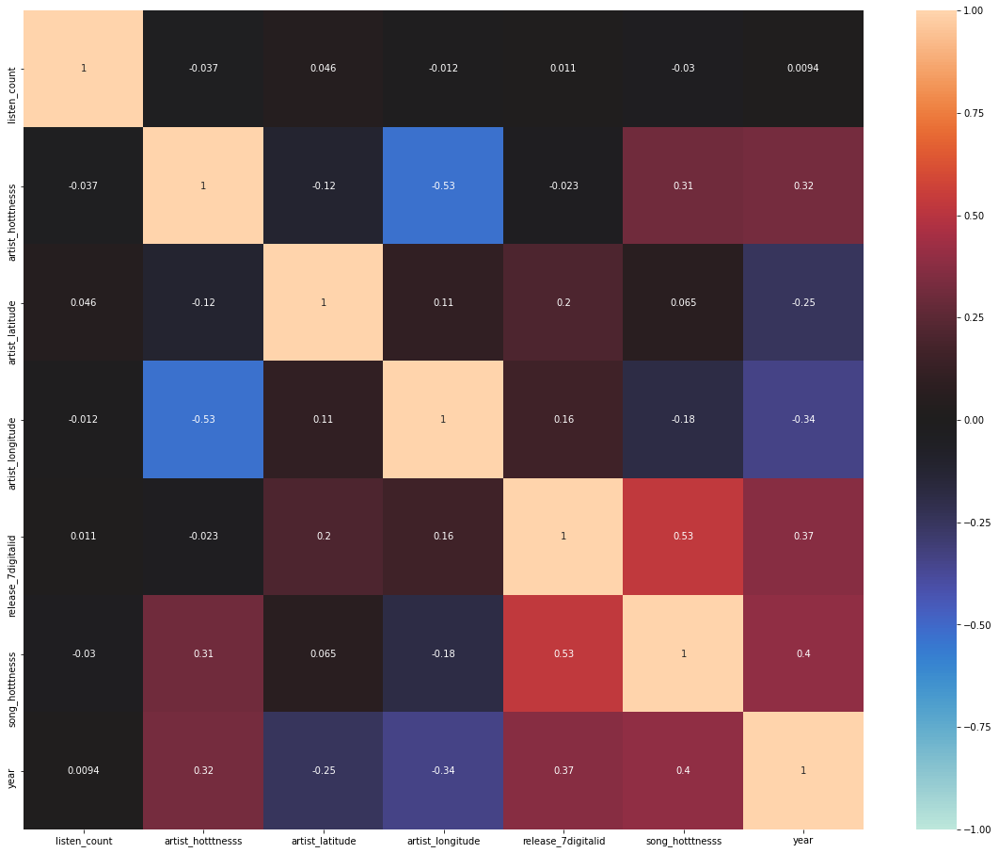

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20,16))
corrmat = songs_metadata_file.corr()
sns.heatmap(corrmat,-1,1,ax=ax,center=0,annot=True);

**Scatter Plot of song_hotttnesss and artist_hotttnesss**

To get the visualization of what we talked about earlier (.31) between song_hotttnesss and artist_hotttnesss , he we see that there is a very slight positive correlation in the data. 

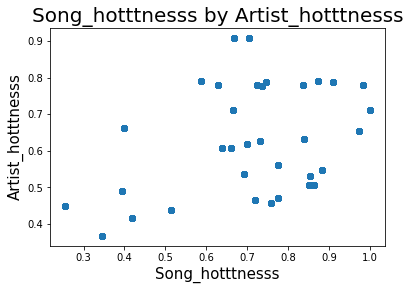

<Figure size 1600x1280 with 0 Axes>

In [ ]:
plt.title('Song_hotttnesss by Artist_hotttnesss', fontsize=20)
plt.xlabel('Song_hotttnesss', fontsize=15)
plt.ylabel('Artist_hotttnesss', fontsize=15)
plt.scatter(songs_metadata_file['song_hotttnesss'], songs_metadata_file['artist_hotttnesss'])
plt.figure(figsize=(20,16), dpi=80)
plt.show()

**Most Popular Artists Visulaization**

Interpretation: 

It might be useful if we visulazied how many times an artist appears in the dataset showing how popular an artist is. The result shows that B.o.B is the most common (Popular) artist in the dataset. This is something that is useful to know because the recommendation engine may recommend some of the artists on this list because there is simply more data points of a certain artist (meaning they are more popular), so they will likely also be recommended more to people.

In [ ]:
mostcommon = songs_metadata_file['artist_name'].value_counts().head(25)
mostcommon

B.o.B                     1822
Linkin Park               1276
Nickelback                 535
Kings Of Leon              524
Rihanna                    340
The White Stripes          251
Daddy Yankee               208
Bad Religion               166
Grizzly Bear               138
Pearl Jam                  126
Rick Astley                125
The Fray                   121
Britney Spears             114
Whitesnake                 114
Death From Above 1979      101
The Rolling Stones          98
bel canto                   98
Semisonic                   96
Hot Chip                    93
Dexys Midnight Runners      92
Alice Cooper                82
Faces                       80
Bersuit Vergarabat          76
Yellowcard                  72
M83                         69
Name: artist_name, dtype: int64

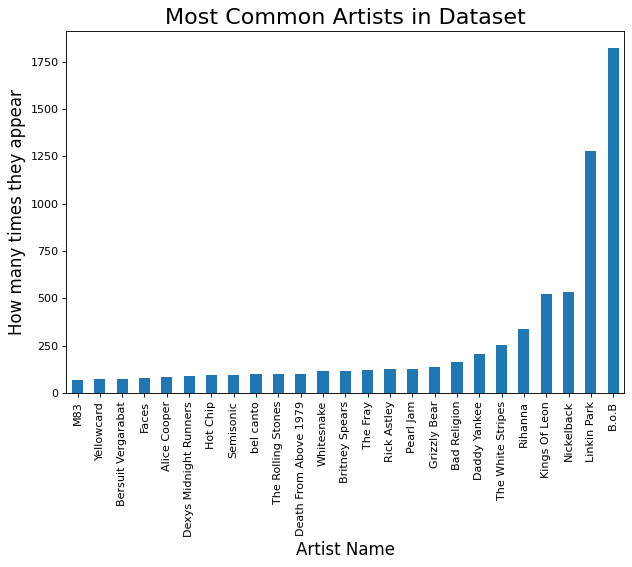

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure

figure(figsize=(9, 6), dpi=80)
plt.title('Most Common Artists in Dataset', fontsize=20)
plt.xlabel('Artist Name', fontsize=15)
plt.ylabel('How many times they appear', fontsize=15)
mostcommon = songs_metadata_file['artist_name'].value_counts().head(25).sort_values().plot(kind = 'bar')

**Map Of Artists**

Interpretation: 

This Map shows the artist names and the location of where they are from. There is alot of artists from the North America, followed by Europe second and finially some from Sounth America and Africa as well. This is simply very interesting information to know where artists come from in this dataset. This information could be useful for recommendation engines because if there is information about user's location data, recommendation engines could take that into account because music does sometimes depend on the geography of an individual.  


In [ ]:
!pip install folium

In [ ]:

#Cite: https://towardsdatascience.com/using-python-to-create-a-world-map-from-a-list-of-country-names-cd7480d03b10
#installation
# Create a world map to show distributions of users 
import folium
from folium.plugins import MarkerCluster
#empty map
from branca.element import Figure
world_map= folium.Map(tiles="cartodbpositron", width=900, height=600, max_zoom=13)
marker_cluster = MarkerCluster().add_to(world_map)
songs_metadata_file=songs_metadata_file.dropna(subset=['artist_latitude'])
songs_metadata_file=songs_metadata_file.dropna(subset=['artist_longitude'])
#for each coordinate, create circlemarker of user percent
for i in range(len(songs_metadata_file)):
        lat = songs_metadata_file.iloc[i]['artist_latitude']
        long = songs_metadata_file.iloc[i]['artist_longitude']
        radius=5
        popup_text = """Country: <br>"""
        popup_text = popup_text.format(songs_metadata_file.iloc[i]['artist_location'])
        folium.CircleMarker(location = [lat, long], radius=radius, popup= popup_text, fill =True).add_to(marker_cluster)
        folium.CircleMarker(location = [lat, long], radius=radius, fill =True).add_to(marker_cluster)
#show the map
world_map


**Most Popular Years Visulaization**

Interpretation: 

Similar to the artists visualization and seeing the most popular artists, it would be useful to see the most common years in the dataset. This could be information that is useful to know because the recommendation engine may sway toward recommeding songs in the same era due to the sheer volume of songs in each year. This somewhat proves the correlation from before.

In [ ]:
songs_metadata_file['year'] = songs_metadata_file['year'].astype('Int64')

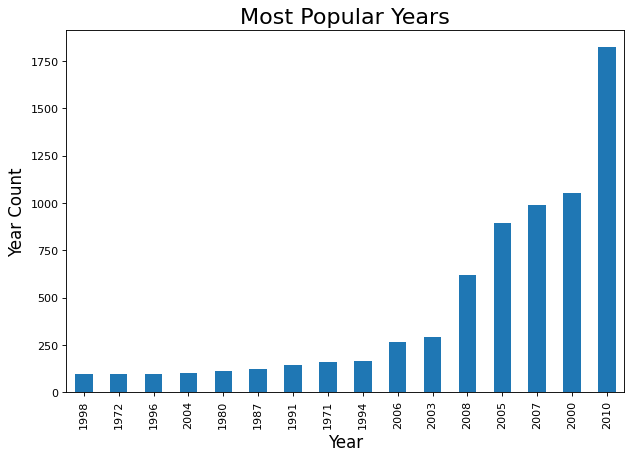

In [ ]:
figure(figsize=(9, 6), dpi=80)
plt.title('Most Popular Years', fontsize=20)
plt.xlabel('Year', fontsize=15)
plt.ylabel('Year Count', fontsize=15)
years = songs_metadata_file['year'].value_counts().sort_values().plot(kind = 'bar')

**Most Popular Albums Visulaization**

Interpretation: 

Similar to artists/years visualization and seeing the most albums and how many times they appear, it would be useful to see the most common albums in the dataset. This could be information that is useful to know because the recommendation engine may sway toward recommeding songs from popular albums because they are simply more popular. For example, B.O.B and Linkin park are the most popular artists, and their albums are the most popular as well. 

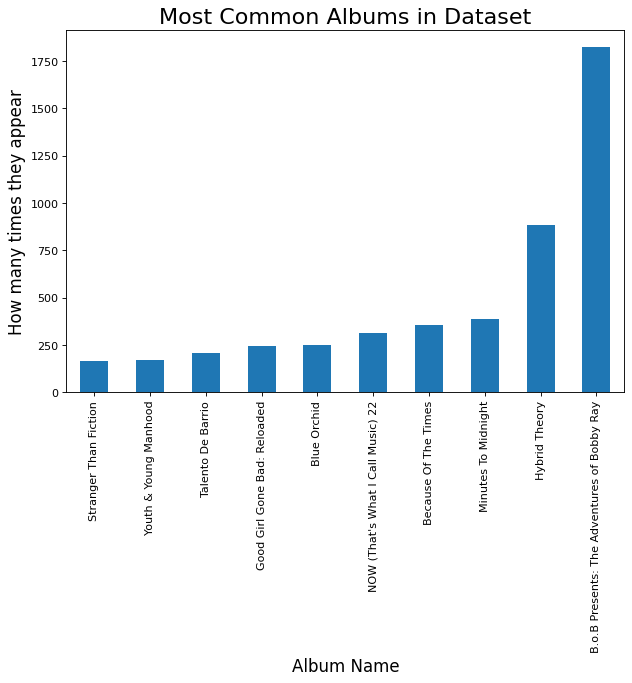

In [ ]:
figure(figsize=(9, 6), dpi=80)
plt.title('Most Common Albums in Dataset', fontsize=20)
plt.xlabel('Album Name', fontsize=15)
plt.ylabel('How many times they appear', fontsize=15)
mostcommon = songs_metadata_file['release'].value_counts().head(10).sort_values().plot(kind = 'bar')

**Pair Plot**

Interpreation:

This pair plot shows the relationship between all the variables and to see if they are compatible to each other or not. This generalizes all the relationships that exist. This is important to understand because it will later on help us understand how the recomender engine will recommend based on variables. 

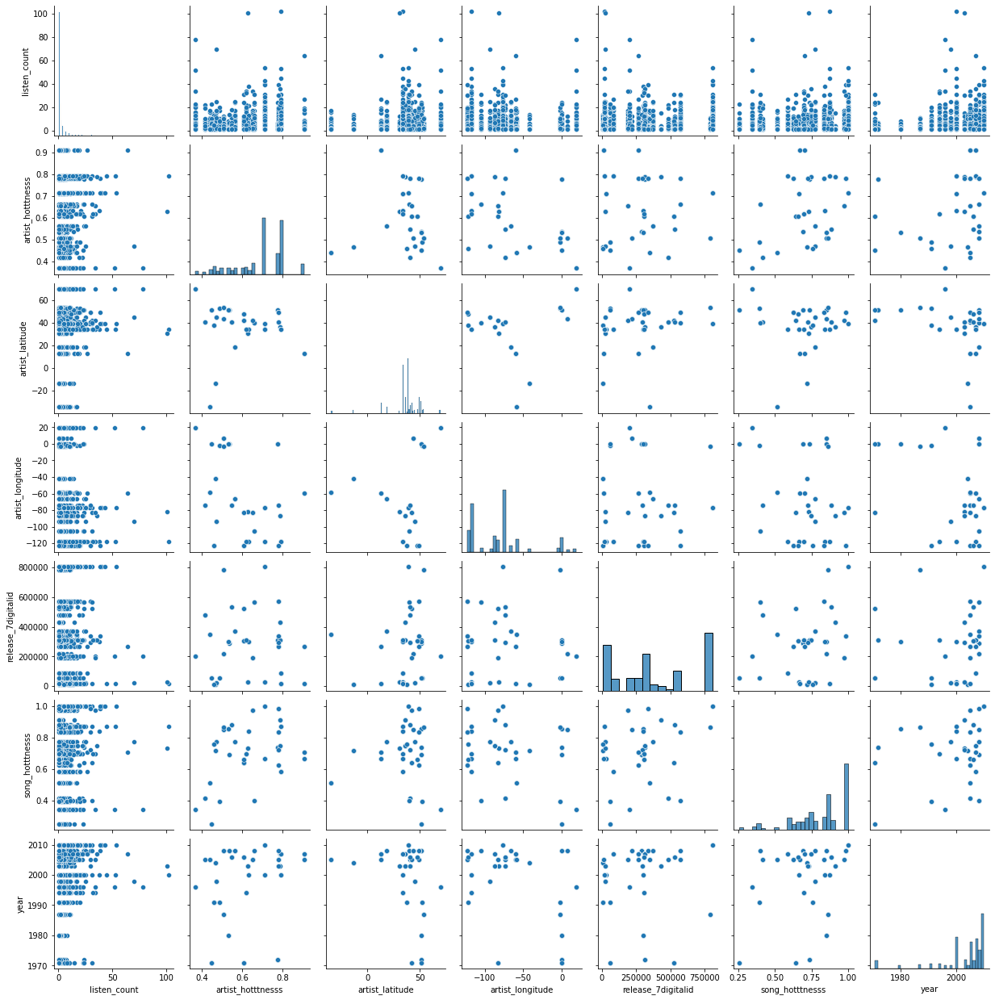

In [ ]:
sns.pairplot(songs_metadata_file)

#**MODELS**

#Simple Linear Model

Tutorial from this website: 

https://towardsdatascience.com/how-to-build-a-simple-song-recommender-296fcbc8c85

Iterpretation:

The following code is a Recommender System model where the system works on  popularity being one of the most important aspects of the recommendation. This recommendation is simply based on trends and songs are recommended based on these trends. The following method "is a naive approach and not personalized. It first gets a unique count of user_id (is the number of times that song was listened to in general by all users) for each song and tag it as a recommendation score. The recommend function then accepts a user_id and outputs the top ten recommended songs for any given user. Keeping in my that since this is the naive approach, the recommendation is not personalized and will be the same for all users."
 



In [ ]:
#Class for Popularity based Recommender System model
class popularity_recommender_py():
    def __init__(self):
        self.train_data = None
        self.user_id = None
        self.item_id = None
        self.popularity_recommendations = None
        
    #Create the popularity based recommender system model
    def create(self, train_data, user_id, item_id):
        self.train_data = train_data
        self.user_id = user_id
        self.item_id = item_id

        #Get a count of user_ids for each unique song as recommendation score
        train_data_grouped = train_data.groupby([self.item_id]).agg({self.user_id: 'count'}).reset_index()
        train_data_grouped.rename(columns = {'user_id': 'score'},inplace=True)
    
        #Sort the songs based upon recommendation score
        train_data_sort = train_data_grouped.sort_values(['score', self.item_id], ascending = [0,1])
    
        #Generate a recommendation rank based upon score
        train_data_sort['Rank'] = train_data_sort['score'].rank(ascending=0, method='first')
        
        #Get the top 10 recommendations
        self.popularity_recommendations = train_data_sort.head(10)

    #Use the popularity based recommender system model to
    #make recommendations
    def recommend(self, user_id):    
        user_recommendations = self.popularity_recommendations
        
        #Add user_id column for which the recommendations are being generated
        user_recommendations['user_id'] = user_id
    
        #Bring user_id column to the front
        cols = user_recommendations.columns.tolist()
        cols = cols[-1:] + cols[:-1]
        user_recommendations = user_recommendations[cols]
        
        return user_recommendations

In [ ]:
#Lets split training and test data
train, test = train_test_split(songs_metadata_file, test_size = 0.3, random_state=0)

**Iterpretation**: 

For the following user, this model predicts these top 10 songs as well as a score for how much they will like the song as well as a rank for user 05f6928b92cb0cb5420aba17934a991bb2eb9766. Again, this model is not personalized and is a native apporch. 

In [ ]:
pm = popularity_recommender_py()
pm.create(train, 'user_id', 'title')
#user the popularity model to make some prediction
user_id = '05f6928b92cb0cb5420aba17934a991bb2eb9766'
pm.recommend(user_id)

,user_id,title,score,Rank
20,05f6928b92cb0cb5420aba17934a991bb2eb9766,Nothin' On You [feat. Bruno Mars] (Album Version),1278,1.0
5,05f6928b92cb0cb5420aba17934a991bb2eb9766,Crawling (Album Version),622,2.0
8,05f6928b92cb0cb5420aba17934a991bb2eb9766,Given Up (Album Version),271,3.0
26,05f6928b92cb0cb5420aba17934a991bb2eb9766,Savin' Me,233,4.0
22,05f6928b92cb0cb5420aba17934a991bb2eb9766,Ragoo,230,5.0
2,05f6928b92cb0cb5420aba17934a991bb2eb9766,Blue Orchid,176,6.0
9,05f6928b92cb0cb5420aba17934a991bb2eb9766,Good Girl Gone Bad,173,7.0
16,05f6928b92cb0cb5420aba17934a991bb2eb9766,Llamado De Emergencia,151,8.0
12,05f6928b92cb0cb5420aba17934a991bb2eb9766,Infected,128,9.0
7,05f6928b92cb0cb5420aba17934a991bb2eb9766,Genius,99,10.0


# Item Similarity Based On Collaborative Filtering

**Interpretation**:

Item Similarity Based on Collaborative Filtering model makes song recommendations that is personalized to each user, this is done by similarity "leveraging the item similarity based collaborative filtering model." This model takes into account what the current user likes as well what others like to make the best recommendation possible. The following is an approach that is  item to item filtering approach, which uses a "co-occurrence matrix based on a song a user likes."



In [ ]:
#CITE https://github.com/dvysardana/RecommenderSystems_PyData_2016/blob/master/Recommenders.py
import numpy as np
import pandas

#Class for Popularity based Recommender System model
class popularity_recommender_py():
    def __init__(self):
        self.train_data = None
        self.user_id = None
        self.item_id = None
        self.popularity_recommendations = None
        
    #Create the popularity based recommender system model
    def create(self, train_data, user_id, item_id):
        self.train_data = train_data
        self.user_id = user_id
        self.item_id = item_id

        #Get a count of user_ids for each unique song as recommendation score
        train_data_grouped = train_data.groupby([self.item_id]).agg({self.user_id: 'count'}).reset_index()
        train_data_grouped.rename(columns = {'user_id': 'score'},inplace=True)
    
        #Sort the songs based upon recommendation score
        train_data_sort = train_data_grouped.sort_values(['score', self.item_id], ascending = [0,1])
    
        #Generate a recommendation rank based upon score
        train_data_sort['Rank'] = train_data_sort['score'].rank(ascending=0, method='first')
        
        #Get the top 10 recommendations
        self.popularity_recommendations = train_data_sort.head(10)

    #Use the popularity based recommender system model to
    #make recommendations
    def recommend(self, user_id):    
        user_recommendations = self.popularity_recommendations
        
        #Add user_id column for which the recommendations are being generated
        user_recommendations['user_id'] = user_id
    
        #Bring user_id column to the front
        cols = user_recommendations.columns.tolist()
        cols = cols[-1:] + cols[:-1]
        user_recommendations = user_recommendations[cols]
        
        return user_recommendations
    

#Class for Item similarity based Recommender System model
class item_similarity_recommender_py():
    def __init__(self):
        self.train_data = None
        self.user_id = None
        self.item_id = None
        self.cooccurence_matrix = None
        self.songs_dict = None
        self.rev_songs_dict = None
        self.item_similarity_recommendations = None
        
    #Get unique items (songs) corresponding to a given user
    def get_user_items(self, user):
        user_data = self.train_data[self.train_data[self.user_id] == user]
        user_items = list(user_data[self.item_id].unique())
        
        return user_items
        
    #Get unique users for a given item (song)
    def get_item_users(self, item):
        item_data = self.train_data[self.train_data[self.item_id] == item]
        item_users = set(item_data[self.user_id].unique())
            
        return item_users
        
    #Get unique items (songs) in the training data
    def get_all_items_train_data(self):
        all_items = list(self.train_data[self.item_id].unique())
            
        return all_items
        
    #Construct cooccurence matrix
    def construct_cooccurence_matrix(self, user_songs, all_songs):
            
        ####################################
        #Get users for all songs in user_songs.
        ####################################
        user_songs_users = []        
        for i in range(0, len(user_songs)):
            user_songs_users.append(self.get_item_users(user_songs[i]))
            
        ###############################################
        #Initialize the item cooccurence matrix of size 
        #len(user_songs) X len(songs)
        ###############################################
        cooccurence_matrix = np.matrix(np.zeros(shape=(len(user_songs), len(all_songs))), float)
           
        #############################################################
        #Calculate similarity between user songs and all unique songs
        #in the training data
        #############################################################
        for i in range(0,len(all_songs)):
            #Calculate unique listeners (users) of song (item) i
            songs_i_data = self.train_data[self.train_data[self.item_id] == all_songs[i]]
            users_i = set(songs_i_data[self.user_id].unique())
            
            for j in range(0,len(user_songs)):       
                    
                #Get unique listeners (users) of song (item) j
                users_j = user_songs_users[j]
                    
                #Calculate intersection of listeners of songs i and j
                users_intersection = users_i.intersection(users_j)
                
                #Calculate cooccurence_matrix[i,j] as Jaccard Index
                if len(users_intersection) != 0:
                    #Calculate union of listeners of songs i and j
                    users_union = users_i.union(users_j)
                    
                    cooccurence_matrix[j,i] = float(len(users_intersection))/float(len(users_union))
                else:
                    cooccurence_matrix[j,i] = 0
                    
        
        return cooccurence_matrix

    
    #Use the cooccurence matrix to make top recommendations
    def generate_top_recommendations(self, user, cooccurence_matrix, all_songs, user_songs):
        print("Non zero values in cooccurence_matrix :%d" % np.count_nonzero(cooccurence_matrix))
        
        #Calculate a weighted average of the scores in cooccurence matrix for all user songs.
        user_sim_scores = cooccurence_matrix.sum(axis=0)/float(cooccurence_matrix.shape[0])
        user_sim_scores = np.array(user_sim_scores)[0].tolist()
 
        #Sort the indices of user_sim_scores based upon their value
        #Also maintain the corresponding score
        sort_index = sorted(((e,i) for i,e in enumerate(list(user_sim_scores))), reverse=True)
    
        #Create a dataframe from the following
        columns = ['user_id', 'song', 'score', 'rank']
        #index = np.arange(1) # array of numbers for the number of samples
        df = pandas.DataFrame(columns=columns)
         
        #Fill the dataframe with top 10 item based recommendations
        rank = 1 
        for i in range(0,len(sort_index)):
            if ~np.isnan(sort_index[i][0]) and all_songs[sort_index[i][1]] not in user_songs and rank <= 10:
                df.loc[len(df)]=[user,all_songs[sort_index[i][1]],sort_index[i][0],rank]
                rank = rank+1
        
        #Handle the case where there are no recommendations
        if df.shape[0] == 0:
            print("The current user has no songs for training the item similarity based recommendation model.")
            return -1
        else:
            return df
 
    #Create the item similarity based recommender system model
    def create(self, train_data, user_id, item_id):
        self.train_data = train_data
        self.user_id = user_id
        self.item_id = item_id

    #Use the item similarity based recommender system model to
    #make recommendations
    def recommend(self, user):
        
        ########################################
        #A. Get all unique songs for this user
        ########################################
        user_songs = self.get_user_items(user)    
            
        print("No. of unique songs for the user: %d" % len(user_songs))
        
        ######################################################
        #B. Get all unique items (songs) in the training data
        ######################################################
        all_songs = self.get_all_items_train_data()
        
        print("no. of unique songs in the training set: %d" % len(all_songs))
         
        ###############################################
        #C. Construct item cooccurence matrix of size 
        #len(user_songs) X len(songs)
        ###############################################
        cooccurence_matrix = self.construct_cooccurence_matrix(user_songs, all_songs)
        
        #######################################################
        #D. Use the cooccurence matrix to make recommendations
        #######################################################
        df_recommendations = self.generate_top_recommendations(user, cooccurence_matrix, all_songs, user_songs)
                
        return df_recommendations
    
    #Get similar items to given items
    def get_similar_items(self, item_list):
        
        user_songs = item_list
        
        ######################################################
        #B. Get all unique items (songs) in the training data
        ######################################################
        all_songs = self.get_all_items_train_data()
        
        print("no. of unique songs in the training set: %d" % len(all_songs))
         
        ###############################################
        #C. Construct item cooccurence matrix of size 
        #len(user_songs) X len(songs)
        ###############################################
        cooccurence_matrix = self.construct_cooccurence_matrix(user_songs, all_songs)
        
        #######################################################
        #D. Use the cooccurence matrix to make recommendations
        #######################################################
        user = ""
        df_recommendations = self.generate_top_recommendations(user, cooccurence_matrix, all_songs, user_songs)
         
        return df_recommendations

In [ ]:
is_model = item_similarity_recommender_py()
is_model.create(train, 'user_id', 'title')

**Interpretation**

The following code shows all the songs similar to any song in our dataset. For example, Nothin' On You by Bruno Mars and B.O.B, is very similar to Crawling according to this model.

In [ ]:
#SINCE THE USER LIKED THOSE SONGS, The USER WILL LIKE SONGS LISTED BELOW AS WELL
is_model.get_similar_items(["Nothin' On You [feat. Bruno Mars] (Album Version)"])

no. of unique songs in the training set: 34
Non zero values in cooccurence_matrix :30


,user_id,song,score,rank
0,,Crawling (Album Version),0.037684,1
1,,Given Up (Album Version),0.011757,2
2,,Ragoo,0.010724,3
3,,Good Girl Gone Bad,0.008339,4
4,,Llamado De Emergencia,0.007047,5
5,,Savin' Me,0.004654,6
6,,Can't Make You Love Me,0.003701,7
7,,Genius,0.003644,8
8,,Infected,0.003569,9
9,,Karma,0.003058,10


#KNN (Recommendation based on Listen count) without using Surprise package
This is a non-parametric classification model where you make recommendations based on what is closest to the current song based on the artists and listen count in order to make recommendations. For example, this can be seen as where people who listen to popular artists and based on the listen count, they will be recommended other artists. Simply, through manual inspection, looking at the data, some of the artists make similar style of music.

Tutorial from this website: 

https://beckernick.github.io/_posts/2016-08-31-music_recommender/


In [ ]:
from scipy.sparse import csr_matrix

In [ ]:
wide_artist_data = songs_metadata_file.pivot_table(index = 'artist_name', columns = 'user_id', values = 'listen_count').fillna(0)
wide_artist_data_sparse = csr_matrix(wide_artist_data.values)

In [ ]:
from sklearn.neighbors import NearestNeighbors

model_knn = NearestNeighbors(metric = 'cosine', algorithm = 'brute')
model_knn.fit(wide_artist_data_sparse)

NearestNeighbors(algorithm='brute', leaf_size=30, metric='cosine',
                 metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                 radius=1.0)

In [ ]:
query_index = 2
distances, indices = model_knn.kneighbors(wide_artist_data.iloc[query_index, :].values.reshape(1, -1), n_neighbors = 6)

for i in range(0, len(distances.flatten())):
    if i == 0:
        print('Recommendations for {0}:\n'.format(wide_artist_data.index[query_index]))
    else:
        print('{0}: {1}, with distance of {2}:'.format(i, wide_artist_data.index[indices.flatten()[i]], distances.flatten()[i]))

Recommendations for Alicia Keys:

1: Rihanna, with distance of 0.9757973064890377:
2: Pearl Jam, with distance of 0.9870752748781844:
3: B.o.B, with distance of 0.9944438175416415:
4: Bersuit Vergarabat, with distance of 0.9963551544879878:
5: Daddy Yankee, with distance of 0.9994963446780459:


#Surprise Package Models (Recommendations For Specific Users)
Surprise is a Python scikit package that allows for building recommendation engines and it also has builtin evaluation metrics that allow the analysis of the models very easy. The Surprise package also has a number of different models that are built in and are ready to use, therefore, it makes it extreamly easy to built recommendation engines. The process is very simple to following any general Machine Learning procedure, where you load up the dataframe passing the rating scale via the Reader function, load up the algorithm, which are the different models that exists and finally fit and predict based on the testset. Then you can evaluate your data via the evaluation metrics.  [Cite](https://http://surpriselib.com/)

In [ ]:
!pip install surprise

     |████████████████████████████████| 11.8MB 292kB/s 
  Created wheel for scikit-surprise: filename=scikit_surprise-1.1.1-cp37-cp37m-linux_x86_64.whl size=1617558 sha256=fddb18c188d2615f395e4e849c02da61d8f84cc596515b9781e6bce59759d97e
  Stored in directory: /root/.cache/pip/wheels/78/9c/3d/41b419c9d2aff5b6e2b4c0fc8d25c538202834058f9ed110d0
Successfully built scikit-surprise


In [ ]:
# Import required modules for reading the dataset
from surprise import Dataset, Reader
#Import SVD
from surprise import SVD
# Optimization and evaluation functions
from surprise.model_selection import train_test_split
from surprise.model_selection import GridSearchCV
from surprise.model_selection import cross_validate
from surprise import accuracy
import pandas as pd
from surprise import KNNBasic,  KNNWithMeans, KNNBaseline
from surprise.model_selection import KFold
from surprise import NormalPredictor
from surprise.model_selection import cross_validate
import matplotlib.pyplot as plt
import seaborn as sns
from surprise import *

#COMPARISON

Before thoroughly training and testing the models with optimal parameters, we will test the algorithms available in the surprise package using their default parameters and compare their performance on the data using Test_RMSE, Fit_time and Test_time on cross-validation procedure. The root mean square error(RMSE) is the square root of the variance of the residuals. It indicates the absolute fit of the model to the data, which indicates how close the observed data points are to the model's predicted values. After comparison we will choose the top 5 algorithms that resulted in the lowest RMSE value and train and test them using their optimal parameters. 


In [ ]:
import surprise as sp

reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(songs_metadata_file[['user_id', 'song_id', 'listen_count']], reader)

benchmark = []
algs = [sp.SVD(), sp.SVDpp(), sp.SlopeOne(), sp.NormalPredictor(), sp.KNNBaseline(), sp.KNNBasic(), sp.KNNWithMeans(), sp.KNNWithZScore(), sp.BaselineOnly(), sp.CoClustering()]
# Iterate over all algorithms
for algorithm in algs:
    # Perform cross validation
    results = cross_validate(algorithm, data, measures=['RMSE'], cv=5, verbose=False)
    
    # Get results & append algorithm name
    tmp = pd.DataFrame.from_dict(results).mean(axis=0)
    tmp = tmp.append(pd.Series([str(algorithm).split(' ')[0].split('.')[-1]], index=['Algorithm']))
    benchmark.append(tmp)

Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Don

In [ ]:
pd.DataFrame(benchmark).set_index('Algorithm').sort_values('test_rmse')

,test_rmse,fit_time,test_time
Algorithm,,,
BaselineOnly,4.207121,0.022699,0.008870
SVD,4.214712,0.362313,0.009630
KNNBaseline,4.220260,0.829193,0.139617
SVDpp,4.225583,0.632830,0.015163
SlopeOne,4.236657,0.056851,0.011810
KNNWithMeans,4.243917,0.875443,0.127970
KNNBasic,4.246173,0.813250,0.130685
CoClustering,4.280096,0.586854,0.008640
KNNWithZScore,4.287874,1.015078,0.135926


The above table shows a list of the algorithms tested and their performance metrics. The table is sorted by the RMSE value in ascending order.
As obsorved our top five models are:
1. BaseLine Only 
2. KNN Baseline
3. SVD
4. SVD++
5. KNNwithmeans

After numerous runs of the comparision we noticed that BaseLine Only, which is one of the simplest algortihms(BaseLine Only evident in the fit and test times) available in the package consistantly ranks as one of the top three models. With furthur research in the surprise package documentation we realised that similar benchmark testing was conducted on two different datasets with RMSE and MAE as the performance metrics which resulted in BaseLine Only outperforming a lot of the more complex algorithms. 

#1. BaseLine Only

The Baseline model is a predicting model that makes predictions based on the Baseline Estimate of the items rating by the user. 
[Cite](chrome-extension://gphandlahdpffmccakmbngmbjnjiiahp/https://courses.ischool.berkeley.edu/i290-dm/s11/SECURE/a1-koren.pdf) 

Here we load up our dataset, and set up custom options for the baseline model

In [ ]:
data = Dataset.load_from_df(songs_metadata_file[['user_id', 'song_id', 'listen_count']], reader)
print('Using ALS')
bsl_options = {'method': 'als',
               'n_epochs': 2,
               'reg_u': 12,
               'reg_i': 5
               }
algo = BaselineOnly(bsl_options=bsl_options)
cross_validate(algo, data, measures=['RMSE'], cv=3, verbose=False)

Using ALS
Estimating biases using als...
Estimating biases using als...
Estimating biases using als...


{'fit_time': (0.00801539421081543, 0.006311655044555664, 0.006773471832275391),
 'test_rmse': array([3.71422317, 4.02284189, 4.89669187]),
 'test_time': (0.013695955276489258,
  0.013953924179077148,
  0.013390302658081055)}

Split our training and test dataset, set up the Baseline algorithm, test, predict and measure the accuracy of the results. 

In [ ]:
trainset, testset = train_test_split(data, test_size=0.25)
algo = BaselineOnly(bsl_options=bsl_options)
predictions = algo.fit(trainset).test(testset)
accuracy.rmse(predictions)

Estimating biases using als...
RMSE: 5.0349


5.0348557333109945

The following functions finds the top 10 songs best estimates for certain users, while also returning the error of the songs. If the function, in the details section, says {'was_impossible': False}, this is actually a good thing, meaning that the function was able to actaully find an estimation and did not simply guess. 

In [ ]:
def get_Iu(uid):
    """ return the number of items rated by given user
    args: 
      uid: the id of the user
    returns: 
      the number of items rated by the user
    """
    try:
        return len(trainset.ur[trainset.to_inner_uid(uid)])
    except ValueError: # user was not part of the trainset
        return 0
    
def get_Ui(iid):
    """ return number of users that have rated given item
    args:
      iid: the raw id of the item
    returns:
      the number of users that have rated the item.
    """
    try: 
        return len(trainset.ir[trainset.to_inner_iid(iid)])
    except ValueError:
        return 0
    
df = pd.DataFrame(predictions, columns=['uid', 'song_id', 'rui', 'est', 'details'])
df['Iu'] = df.uid.apply(get_Iu)
df['Ui'] = df.song_id.apply(get_Ui)
df['err'] = abs(df.est - df.rui)
best_predictions = df.sort_values(by='err')[:10]

The head of the predictions table, where we have the est (how much a user would like a song), details (was is impossible to find an estimate or not), iu (items rated by given user args, ui (gives the number of users that have rated given item args), and finally the err (the error rate based on the estimate (est).

In [ ]:
best_predictions.head()

,uid,song_id,rui,est,details,Iu,Ui,err
0,815a5b7142d081fd053aa756faa6a03829cfbfda,SOCWJDB12A58A776AF,2.0,2.002026,{'was_impossible': False},0,98,0.002026
1553,fdf9f38bf454bfc4918dc3cc3de329f80c2984fd,SOCWJDB12A58A776AF,2.0,2.002026,{'was_impossible': False},0,98,0.002026
457,2a11514ee3242ff6830b76767ccdb2beb13ed047,SOCWJDB12A58A776AF,2.0,2.002026,{'was_impossible': False},0,98,0.002026
1082,ac1e332c68e1610157e99ed50cfc05315ad5f498,SOCWJDB12A58A776AF,2.0,2.002026,{'was_impossible': False},0,98,0.002026
307,f76cdb6643cc684ddbf42efa079deb409d128416,SOCWJDB12A58A776AF,2.0,2.002026,{'was_impossible': False},0,98,0.002026


Here we merge the meta data file to the prediction file.

In [ ]:
best_predictions_1 = best_predictions.merge(songs_metadata_file, how='left', left_on=['uid','song_id'], right_on = ['user_id','song_id'])

Show the columns that are neccessary and the top 10 estimates as well and the users and song information for those estimates. 

In [ ]:
best_predictions_1[['user_id', 'song_id', 'title', 'artist_name','listen_count', 'est', 'err']].sort_values(by='est', ascending=False)

,user_id,song_id,title,artist_name,listen_count,est,err
6,0098725cfea903f0ce2f4d20ac3d2b4ee8edbec8,SOTRDVJ12A8C13975E,Savin' Me,Nickelback,3,2.992794,0.007206
7,c0b6a5e7b0c8fe4d1468749985448cb3b2a00625,SOTRDVJ12A8C13975E,Savin' Me,Nickelback,3,2.992794,0.007206
8,89345513bf71ff86cdb94b78bd6e9395c5afb620,SOTRDVJ12A8C13975E,Savin' Me,Nickelback,3,2.992794,0.007206
9,63e97eadc0f9d378830b16cfe90a47628c7828ae,SOTRDVJ12A8C13975E,Savin' Me,Nickelback,3,2.992794,0.007206
0,815a5b7142d081fd053aa756faa6a03829cfbfda,SOCWJDB12A58A776AF,Never Gonna Give You Up,Rick Astley,2,2.002026,0.002026
1,fdf9f38bf454bfc4918dc3cc3de329f80c2984fd,SOCWJDB12A58A776AF,Never Gonna Give You Up,Rick Astley,2,2.002026,0.002026
2,2a11514ee3242ff6830b76767ccdb2beb13ed047,SOCWJDB12A58A776AF,Never Gonna Give You Up,Rick Astley,2,2.002026,0.002026
3,ac1e332c68e1610157e99ed50cfc05315ad5f498,SOCWJDB12A58A776AF,Never Gonna Give You Up,Rick Astley,2,2.002026,0.002026
4,f76cdb6643cc684ddbf42efa079deb409d128416,SOCWJDB12A58A776AF,Never Gonna Give You Up,Rick Astley,2,2.002026,0.002026
5,a177a9a870953ac86d48e86411d564d45b514a72,SOCWJDB12A58A776AF,Never Gonna Give You Up,Rick Astley,2,2.002026,0.002026


In [ ]:
best_predictions_2 = df.merge(songs_metadata_file, how='left', left_on=['uid','song_id'], right_on = ['user_id','song_id'])

We also now have the ability to pick a random user and a song and see an estimate of how much they would like the song. 

In [ ]:
# pick a song
song = best_predictions_2['title'].iloc[5]
# pick an user
user = best_predictions_2['user_id'].iloc[5]

prediction = best_predictions_2.est.iloc[5]

# print prediction
print(f"The estimate rating that the user {user} will give to the song {song} is {prediction}")

The estimate rating that the user 60da21a6a516314ffb947a1df411ebfba326e7ed will give to the song Nothin' On You [feat. Bruno Mars] (Album Version) is 2.807873384623522


#2. KNN Baseline
KNNBaseline is a basic collaborative filtering algorithm taking into account a baseline rating [Cite](https://https://surprise.readthedocs.io/en/stable/getting_started.html).

In [ ]:
#KNNBaseline
kf = KFold(n_splits=3)
algo = KNNBaseline(k=3)
best_algo = None
best_rmse = 1000.0
best_pred = None
for trainset, testset in kf.split(data):
    # train and test algorithm.
    algo.fit(trainset)
    predictions = algo.test(testset)
    # Compute and print Root Mean Squared Error
    rmse = accuracy.rmse(predictions, verbose=True)
    if rmse < best_rmse:
        best_rmse = rmse
        best_algo = algo
        best_pred = predictions

Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 4.5652
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 3.5715
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 4.6135


In [ ]:
# get the list of the song ids
unique_ids = songs_metadata_file['song_id'].unique()

# get the list of the ids that the userid 05f6928b92cb0cb5420aba17934a991bb2eb9766 has rated
iids1001 = songs_metadata_file.loc[songs_metadata_file['user_id'] =='05f6928b92cb0cb5420aba17934a991bb2eb9766', 'song_id']

# remove the rated songs for the recommendations
songs_to_predict = np.setdiff1d(unique_ids,iids1001)

In [ ]:
my_recs = []
for iid in songs_to_predict:
    my_recs.append((iid, algo.predict(uid='05f6928b92cb0cb5420aba17934a991bb2eb9766',iid=iid).est))

best_pred = pd.DataFrame(my_recs, columns=['song_id', 'predictions']).sort_values('predictions')[:10]

In [ ]:
best_pred1 = best_pred.merge(songs_metadata_file, on = ['song_id'])

In [ ]:
best_pred1[['user_id', 'song_id', 'title', 'artist_name','listen_count', 'predictions']].sort_values(by='predictions', ascending=False).head(10)

,user_id,song_id,title,artist_name,listen_count,predictions
1015,8f80b67b63b17fb3260ddca3bc54a4579c675c2d,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,1,2.10337
979,8aab962d9a89e14f80249e7d91a441b36f762c88,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,12,2.10337
963,9870b519630cf39da78a9f3d7f4da6a6ef4360b8,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,1,2.10337
964,aecf7f74f456558399c5d11a04f33c9cf3c6f17f,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,2,2.10337
965,b735719dea03084b81b65434821b26e81de04830,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,1,2.10337
966,fd490a608a6d667facbd4db34429598fe24d6997,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,2,2.10337
967,968b17045b81da16507d3553d884a6f3fb73176b,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,1,2.10337
968,47937aa48f00c953591be7074146ff6cbe9b6a0f,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,5,2.10337
969,d27a28c441ecc0a92ab27293a56ad60e19d7291c,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,1,2.10337
970,d62efa291178e2bfbe6501e885d74615a5dfe21a,SOJDXQI12AF72A580E,One Year_ Six Months,Yellowcard,1,2.10337


In [ ]:
# pick a song
song = best_pred1['title'].iloc[5]
# pick an user
user = best_pred1['user_id'].iloc[5]

prediction = best_pred1.predictions.iloc[5]

# print prediction
print(f"The estimate rating that the user {user} will give to the song {song} is {prediction}")  

The estimate rating that the user 1da1afacd9ed8627d314df635b45ec4b429395e4 will give to the song Genius is 1.4656602309197648


#3. SVD
SVD (Singular Value Decomposition) model is a model that uses matrix factorization to make prediction based on a matrix representation of the dataset.

Sources: 

- https://surprise.readthedocs.io/en/stable/matrix_factorization.html#surprise.prediction_algorithms.matrix_factorization.SVD

- https://analyticsindiamag.com/singular-value-decomposition-svd-application-recommender-system/

- https://www.jiristodulka.com/post/recsys_cf/

- https://predictivehacks.com/how-to-run-recommender-systems-in-python/


In [ ]:
# We'll split into the trainset and testset
trainset, testset = train_test_split(data, test_size=.25)

The code block below is used to find the right number of n_factors and n_epochs in order to use SVD and to avoid underfitting. To do this, we use GridSearchCV to find n_factors and n_epochs value.

In [ ]:
param_grid = {'n_factors': [120, 160], 'n_epochs': [100, 110], 'lr_all': [0.001, 0.005], 'reg_all': [0.08, 0.12]}
              
grid_search_svd = GridSearchCV(SVD, param_grid, measures=['rmse'], cv=3, joblib_verbose=4, n_jobs=-2)
grid_search_svd.fit(data)
find_algo = grid_search_svd.best_estimator['rmse']
print(grid_search_svd.best_score['rmse'])
print(grid_search_svd.best_params['rmse'])

# Perform the cross validation
cross_validate(find_algo, data, measures=['RMSE'], cv=5, verbose=True)

[Parallel(n_jobs=-2)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=-2)]: Done   1 out of   1 | elapsed:    1.6s remaining:    0.0s
[Parallel(n_jobs=-2)]: Done   2 out of   2 | elapsed:    3.2s remaining:    0.0s
[Parallel(n_jobs=-2)]: Done   3 out of   3 | elapsed:    4.8s remaining:    0.0s
[Parallel(n_jobs=-2)]: Done  48 out of  48 | elapsed:  1.5min finished


4.232257620001769
{'n_factors': 120, 'n_epochs': 100, 'lr_all': 0.001, 'reg_all': 0.08}
Evaluating RMSE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    5.7228  3.2489  3.3805  4.5705  3.7929  4.1431  0.9145  
Fit time          1.92    1.89    1.90    1.91    1.91    1.90    0.01    
Test time         0.01    0.01    0.01    0.01    0.01    0.01    0.00    


{'fit_time': (1.9180152416229248,
  1.8869495391845703,
  1.9020850658416748,
  1.9089231491088867,
  1.905165195465088),
 'test_rmse': array([5.72275117, 3.24893285, 3.38049753, 4.57047706, 3.79287941]),
 'test_time': (0.009127378463745117,
  0.00999307632446289,
  0.010169506072998047,
  0.009493112564086914,
  0.00947713851928711)}

After getting those numbers, we plug them in SVD model to train it for use in our song recommender system

In [ ]:
# After getting the best parameters, we fit the model again
final_algorithm = SVD(n_factors=120, n_epochs=110, lr_all=0.005, reg_all=0.1)
final_algorithm.fit(trainset)

# And we test it
test_predictions = final_algorithm.test(testset)

# Get the accuracy
print(f"The RMSE is {accuracy.rmse(test_predictions, verbose=True)}")

RMSE: 4.9906
The RMSE is 4.990636609926379


Below is how we get the recommendations according to SVD. After properly trained the model, we start to get a list of unique song ids and the list of song ids rated by a specific user and remove the suggested songs that had been rated by that user to make a new prediction. 

In [ ]:
# get the list of the song ids
unique_ids = songs_metadata_file['song_id'].unique()

# get the list of the ids that the userid 05f6928b92cb0cb5420aba17934a991bb2eb9766 has rated
iids1001 = songs_metadata_file.loc[songs_metadata_file['user_id'] =='05f6928b92cb0cb5420aba17934a991bb2eb9766', 'song_id']

# remove the rated songs for the recommendations
songs_to_predict = np.setdiff1d(unique_ids,iids1001)

Here we are using our trained SVD model to make a new recommendation to that specific user.

In [ ]:
my_recs = []
for iid in songs_to_predict:
    my_recs.append((iid, final_algorithm.predict(uid='05f6928b92cb0cb5420aba17934a991bb2eb9766',iid=iid).est))

best_pred = pd.DataFrame(my_recs, columns=['song_id', 'predictions']).sort_values('predictions')[:10]

In [ ]:
best_pred1 = best_pred.merge(songs_metadata_file, on = ['song_id'])

In [ ]:
best_pred1[['user_id', 'song_id', 'title', 'artist_name','listen_count', 'predictions']].sort_values(by='predictions', ascending=False).head(10)

,user_id,song_id,title,artist_name,listen_count,predictions
995,24b98f8ab023f6e7a1c37c7729c623f7b821eb95,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202
969,ca387cc7d73e0a6f5402caddff70a9fd35c4db37,SOZCARG12A6D4F74D1,Simon,Lifehouse,2,2.19202
967,2046c3e062253cf7d0540172d77db09bbb8dd8b7,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202
966,e6841dd18dd4f18ae50b8b161c84c048c32f792e,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202
965,61815a85348e71734078c0365e01099434dd695a,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202
964,bd20c9f3789ffb794863316a5583cf94dea5cafc,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202
963,ac7e90d2cd1a70e5ac847404afe86b1c741b0ff7,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202
962,a99f8c2def554cbbbb74459fc97ba4cc4c0c3845,SOZCARG12A6D4F74D1,Simon,Lifehouse,2,2.19202
961,de5cfa96fc3f51923cb9c3b2d985e849ae48097f,SOZCARG12A6D4F74D1,Simon,Lifehouse,3,2.19202
960,181e651502baa899e1961b81ca544b9625cc2602,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.19202


In [ ]:
# pick a song
song = best_pred1['title'].iloc[5]
# pick an user
user = best_pred1['user_id'].iloc[5]

prediction = best_pred1.predictions.iloc[5]

# print prediction
print(f"The estimate rating that the user {user} will give to the song {song} is {prediction}")                                               

The estimate rating that the user f448c72e5a84426e12c94202d743319b9b5343c0 will give to the song Hold On is 1.496350019229617


#4. SVD++

SVD++ (Singular Value Decomposition++) model is a model that uses matrix factorization to make prediction based on a matrix representation of the dataset like SVD because it is an extension of SVD.

Sources:

- https://surprise.readthedocs.io/en/stable/matrix_factorization.html#surprise.prediction_algorithms.matrix_factorization.SVDpp

- https://predictivehacks.com/how-to-run-recommender-systems-in-python/

- https://en.wikipedia.org/wiki/Matrix_factorization_(recommender_systems)#SVD++

Same with SVD, the code block below is used to find the right number of n_factors and n_epochs in order to use SVD++ and to avoid underfitting. To do this, we use GridSearchCV to find n_factors and n_epochs value.

In [ ]:
param_grid = {'n_factors': [120, 160], 'n_epochs': [100, 110], 'lr_all': [0.001, 0.005], 'reg_all': [0.08, 0.12]}
              
grid_search_svdpp = GridSearchCV(SVDpp, param_grid, measures=['rmse'], cv=3, joblib_verbose=4, n_jobs=-2)
grid_search_svdpp.fit(data)
find_algo = grid_search_svdpp.best_estimator['rmse']
print(grid_search_svdpp.best_score['rmse'])
print(grid_search_svdpp.best_params['rmse'])

# Perform the cross validation
cross_validate(find_algo, data, measures=['RMSE'], cv=5, verbose=True)

[Parallel(n_jobs=-2)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=-2)]: Done   1 out of   1 | elapsed:    5.1s remaining:    0.0s
[Parallel(n_jobs=-2)]: Done   2 out of   2 | elapsed:   10.1s remaining:    0.0s
[Parallel(n_jobs=-2)]: Done   3 out of   3 | elapsed:   15.0s remaining:    0.0s
[Parallel(n_jobs=-2)]: Done  48 out of  48 | elapsed:  4.7min finished


4.260563702557305
{'n_factors': 160, 'n_epochs': 100, 'lr_all': 0.005, 'reg_all': 0.12}
Evaluating RMSE of algorithm SVDpp on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    4.7780  3.8497  4.6007  3.3776  4.5436  4.2299  0.5305  
Fit time          7.29    7.09    7.27    7.33    7.26    7.25    0.08    
Test time         0.01    0.02    0.01    0.01    0.02    0.01    0.00    


{'fit_time': (7.287286281585693,
  7.091994524002075,
  7.266211032867432,
  7.332218885421753,
  7.263429641723633),
 'test_rmse': array([4.77800367, 3.84969227, 4.60073667, 3.37756739, 4.54363742]),
 'test_time': (0.01377558708190918,
  0.015540599822998047,
  0.014693021774291992,
  0.013813018798828125,
  0.015271663665771484)}

After getting those numbers, we plug them in SVD++ model to train it for use in our song recommender system

In [ ]:
# After getting the best parameters, we fit the model again
final_algorithm2 = SVDpp(n_factors=120, n_epochs=100, lr_all=0.005, reg_all=0.12)
final_algorithm2.fit(trainset)

# And we test it
test_predictions = final_algorithm2.test(testset)

# Get the accuracy
print(f"The RMSE is {accuracy.rmse(test_predictions, verbose=True)}")

RMSE: 5.0239
The RMSE is 5.023876379384735


Below is how we get the recommendations according to SVD++. After properly trained the model, we start to get a list of unique song ids and the list of song ids rated by a specific user and remove the suggested songs that had been rated by that user to make a new prediction. 

In [ ]:
# get the list of the song ids
unique_ids = songs_metadata_file['song_id'].unique()

# get the list of the ids that the userid 05f6928b92cb0cb5420aba17934a991bb2eb9766 has rated
iids1001 = songs_metadata_file.loc[songs_metadata_file['user_id'] =='05f6928b92cb0cb5420aba17934a991bb2eb9766', 'song_id']

# remove the rated songs for the recommendations
songs_to_predict = np.setdiff1d(unique_ids,iids1001)

Here we are using our trained SVD++ model to make a new recommendation to that specific user.

In [ ]:
my_recs = []
for iid in songs_to_predict:
    my_recs.append((iid, final_algorithm2.predict(uid='05f6928b92cb0cb5420aba17934a991bb2eb9766',iid=iid).est))
    
best_pred = pd.DataFrame(my_recs, columns=['song_id', 'predictions']).sort_values('predictions')[:10]

In [ ]:
best_pred1 = best_pred.merge(songs_metadata_file, on = ['song_id'])

In [ ]:
best_pred1[['user_id', 'song_id', 'title', 'artist_name','listen_count', 'predictions']].sort_values(by='predictions', ascending=False).head(10)

,user_id,song_id,title,artist_name,listen_count,predictions
995,24b98f8ab023f6e7a1c37c7729c623f7b821eb95,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885
969,ca387cc7d73e0a6f5402caddff70a9fd35c4db37,SOZCARG12A6D4F74D1,Simon,Lifehouse,2,2.507885
967,2046c3e062253cf7d0540172d77db09bbb8dd8b7,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885
966,e6841dd18dd4f18ae50b8b161c84c048c32f792e,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885
965,61815a85348e71734078c0365e01099434dd695a,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885
964,bd20c9f3789ffb794863316a5583cf94dea5cafc,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885
963,ac7e90d2cd1a70e5ac847404afe86b1c741b0ff7,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885
962,a99f8c2def554cbbbb74459fc97ba4cc4c0c3845,SOZCARG12A6D4F74D1,Simon,Lifehouse,2,2.507885
961,de5cfa96fc3f51923cb9c3b2d985e849ae48097f,SOZCARG12A6D4F74D1,Simon,Lifehouse,3,2.507885
960,181e651502baa899e1961b81ca544b9625cc2602,SOZCARG12A6D4F74D1,Simon,Lifehouse,1,2.507885


In [ ]:
# pick a song
song = best_pred1['title'].iloc[5]
# pick an user
user = best_pred1['user_id'].iloc[5]

prediction = best_pred1.predictions.iloc[5]

# print prediction
print(f"The estimate rating that the user {user} will give to the song {song} is {prediction}")  

The estimate rating that the user 49c20ac7942e9978fc91df6a58805a5815a0aeb2 will give to the song Music Of The Sun is 2.0183424211698013


#5. KNNWithMeans
KNNWithMeans is basic collaborative filtering algorithm, taking into account the mean ratings of each user [Cite](https://https://surprise.readthedocs.io/en/stable/knn_inspired.html).

In [ ]:
#KNNWithMeans
sim_options = { 'name': 'cosine' ,'user_based':  False}
kf = KFold(n_splits=5)
algo = KNNWithMeans(k =3 , sim_options = sim_options)
best_algo = None
best_rmse = 1000.0
best_pred = None
for trainset, testset in kf.split(data):
    # train and test algorithm.
    algo.fit(trainset)
    predictions = algo.test(testset)
    # Compute and print Root Mean Squared Error
    rmse = accuracy.rmse(predictions, verbose=True)
    if rmse < best_rmse:
        best_rmse= rmse
        best_algo = algo
        best_pred = predictions
print("Best", best_rmse)

Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 3.8291
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 4.2752
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 4.4436
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 3.9386
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 4.9357
Best 3.829056048060684


In [ ]:
pred_df = pd.DataFrame(best_pred).merge(songs_metadata_file , left_on = ['uid', 'iid'], right_on = ['user_id', 'song_id'])

In [ ]:
pred_df[['uid', 'iid', 'user_id', 'title', 'song_id', 'est']]

,uid,iid,user_id,title,song_id,est
0,05c73deb40cec96c2cf571c36cea7fe9a9bb394d,SOJDHGS12A6310D85E,05c73deb40cec96c2cf571c36cea7fe9a9bb394d,Rocks Off,SOJDHGS12A6310D85E,2.704545
1,eb4e82f2aff295a201200a1dce8f31d5932b9dac,SOTRDVJ12A8C13975E,eb4e82f2aff295a201200a1dce8f31d5932b9dac,Savin' Me,SOTRDVJ12A8C13975E,2.704545
2,b3e45107cc3f89766de8836520acecb17ae62b57,SOULTKQ12AB018A183,b3e45107cc3f89766de8836520acecb17ae62b57,Nothin' On You [feat. Bruno Mars] (Album Version),SOULTKQ12AB018A183,2.704545
3,479d26eaa837328ce91ac46b12d87d3d4f73922c,SOXDMAC12AB017E7FF,479d26eaa837328ce91ac46b12d87d3d4f73922c,Little Brother,SOXDMAC12AB017E7FF,2.704545
4,8d2d11b4a2dfff547c9f88fc223a23c6277947b3,SOPWKOX12A8C139D43,8d2d11b4a2dfff547c9f88fc223a23c6277947b3,Genius,SOPWKOX12A8C139D43,1.000000
...,...,...,...,...,...,...
1403,e80c9017f37d77a2bb86c571f686fceb68c0f456,SOULTKQ12AB018A183,e80c9017f37d77a2bb86c571f686fceb68c0f456,Nothin' On You [feat. Bruno Mars] (Album Version),SOULTKQ12AB018A183,2.704545
1404,66bd4c6f5c6760396674346606215cc8e770ec6a,SOULTKQ12AB018A183,66bd4c6f5c6760396674346606215cc8e770ec6a,Nothin' On You [feat. Bruno Mars] (Album Version),SOULTKQ12AB018A183,2.704545
1405,94c6d4cf1cb0d3557e3df938d9b9594d47519aab,SOKZTHA12A8C134830,94c6d4cf1cb0d3557e3df938d9b9594d47519aab,Good Girl Gone Bad,SOKZTHA12A8C134830,2.704545
1406,508aa8499f1174b3289242dee59f49473656e401,SOTRDVJ12A8C13975E,508aa8499f1174b3289242dee59f49473656e401,Savin' Me,SOTRDVJ12A8C13975E,2.704545


In [ ]:
pred_df[['uid', 'iid', 'user_id', 'title', 'song_id', 'est']].sort_values(by='est', ascending=False).head(10)

,uid,iid,user_id,title,song_id,est
1124,38b4446f747464f951948ee3a84a1f83549ca07b,SOZAPQT12A8C142821,38b4446f747464f951948ee3a84a1f83549ca07b,Ragoo,SOZAPQT12A8C142821,10.000000
586,422fdf853edaa22cfbf7956630d1a9d702d4072c,SOULTKQ12AB018A183,422fdf853edaa22cfbf7956630d1a9d702d4072c,Nothin' On You [feat. Bruno Mars] (Album Version),SOULTKQ12AB018A183,10.000000
717,2ee5c944482744058c7f483535b30a69c6c0994e,SOHTWLT12A8C13CFE1,2ee5c944482744058c7f483535b30a69c6c0994e,Inside Job,SOHTWLT12A8C13CFE1,10.000000
903,ca4ff97c0f7640f5c2f1f71498439b7fcf6a7ac9,SOJDXQI12AF72A580E,ca4ff97c0f7640f5c2f1f71498439b7fcf6a7ac9,One Year_ Six Months,SOJDXQI12AF72A580E,10.000000
22,37f248812bb73e8d8dc5a50b96e6855994c34038,SOWEUOO12A6D4F6D0C,37f248812bb73e8d8dc5a50b96e6855994c34038,Given Up (Album Version),SOWEUOO12A6D4F6D0C,10.000000
25,257c2c2b50912f932d86fcd74fbc90245a469e70,SOEKSGJ12A67AE227E,257c2c2b50912f932d86fcd74fbc90245a469e70,Crawling (Album Version),SOEKSGJ12A67AE227E,9.881833
1041,f7ccca3b73026ec2c89d4dba8146e17ea1e55f42,SOWEUOO12A6D4F6D0C,f7ccca3b73026ec2c89d4dba8146e17ea1e55f42,Given Up (Album Version),SOWEUOO12A6D4F6D0C,9.589861
59,257c2c2b50912f932d86fcd74fbc90245a469e70,SOWEUOO12A6D4F6D0C,257c2c2b50912f932d86fcd74fbc90245a469e70,Given Up (Album Version),SOWEUOO12A6D4F6D0C,9.471694
407,e5f45ea58629525460d026655b430d738826a6d7,SOEKSGJ12A67AE227E,e5f45ea58629525460d026655b430d738826a6d7,Crawling (Album Version),SOEKSGJ12A67AE227E,9.117389
159,6cc217e3de72012162fa8852f623056361607c7b,SOULTKQ12AB018A183,6cc217e3de72012162fa8852f623056361607c7b,Nothin' On You [feat. Bruno Mars] (Album Version),SOULTKQ12AB018A183,8.860372


In [ ]:
# pick a song
song = pred_df['title'].iloc[5]
# pick an user
user = pred_df['user_id'].iloc[5]

prediction = pred_df.est.iloc[5]

# print prediction
print(f"The estimate rating that the user {user} will give to the song {song} is {prediction}")  

The estimate rating that the user 858971f9f9f5326a9320031a3c4d168036784095 will give to the song Nothin' On You [feat. Bruno Mars] (Album Version) is 2.7045454545454546


#**Conclusion/Summary of Performance**

After evaluating five different models trained to take in a large dataset of songs so it can work in our song recommender system, we are able to answer our business question that we stated in overview: Creating a recommendation engine for music to help people explore similar music that they usually listen to and we will choose the best model to be part of the recommendation engine.


First, there were multiple recommendation engines built in order to understand which way to recommend music to people, before exploring the surprise package which allows for easy estimation of how much a user would like each song based on their listen count. A Recommender System model was created using a Simple Linear Model, this model made ten song recommendations that are not personalized and will be the same for all users. Next, the Item Similarity model based on Collaborative Filtering was created, and took into account what the current user likes as well as what others like in order to make the best recommendation possible. This method used a co-occurrence matrix based on a song a user likes, and this method outputted ten songs as well as a score and rank of how much a song is similar to another song. Next, a KNN model made recommendations based on the listen count without using the Surprise package, this method simply made recommendations based on what its closest data point was taking into account the artists and listen count in order to make other recommendations similar to the artist. This method named five artists similar to an artist inputted. 

Next, the main models of this project were 5 models from the Surprise Python package, which is one of the most popular packages and is usually used to build a recommender system. Surprise recommender package has a built-in benchmark system that can be used to compare these models using RMSE accuracy score in order to find out that which model is our best choice to be used in our business question. 

In our experiment, we have two different runs for the models. The first run is without optimization to find the best 5 models. The second run is with optimization to see which model is really the best among those best 5 models we find when we run without optimization. The results we get from running without optimization are:

**Before Optimzation**
-	**Baseline result: 4.124615**
-	**KNN baseline: 4.206053**
-	**SVD: 4.217890**
-	**SVD++: 4.229273**
-	**KNN with means: 4.253692**

The result for the best model turns out to be baseline model when we run the benchmark from Surprise without optimization. This seems to be inaccurate because it doesnt make much sense that the baseline is the best model because it is simply predicts based on the distribution in the training set. Therefore, we decide to run these top 5 models again with optimization and this is our new results.

**After Optimzation**
-	**KNN with means: 3.4091**
-	**KNN baseline: 3.6989**
-	**SVD: 3.8965**
-	**SVD++: 3.9065**
-	**Baseline result: 4.1106**


The new and final result we get is KNN with means being the best model. Therefore, to answer our business question, the best model we will choose for our music recommender system would be the KNN with means model based on the benchmark result that we got from Surprise. However, we recognize that even after optimization, we did not use the perfect optimization metrics and each model could even be more effient to reduce the RSME. 


